## Get prediction

In [14]:
%matplotlib inline
import matplotlib.pyplot as plt

import sys
import numpy as np
import torch

sys.path.insert(0, '..')
from isegm.ritm.utils import vis, exp

from isegm.inference import utils
from isegm.inference.iterative_evaluation_training import evaluate_sample
from isegm.inference.clicker import Clicker, DynamicClicker
from isegm.ritm.inference.evaluation_explainable import evaluate_sample as evaluate_sample_explainable
from isegm.data.preprocess import Preprocessor

device = torch.device('cuda:0')
cfg = exp.load_config_file('config.yml', return_edict=True)

In [2]:
from isegm.inference.predictors.unetplusplus_predictor import get_predictor
from isegm.model.is_unetplusplus_model import UnetPlusPlusModel

In [16]:
from isegm.inference import utils

TRAINING_OUTPUT_PATH = '/gpfs/space/projects/PerkinElmer/donatasv_experiments/repos/ClickSEG/outputs/training'

# checkpoint_path = utils.find_checkpoint(cfg.INTERACTIVE_MODELS_PATH, 'aligned_augmentations.pth')

# checkpoint_path = utils.find_checkpoint_from_training(TRAINING_OUTPUT_PATH, 'UnetPlusPlus-baseline_gaussian_standard_aug_no_crop')
checkpoint_path = '/gpfs/space/projects/PerkinElmer/donatasv_experiments/repos/ClickSEG/outputs/training/final_models/UnetPlusPlus-MD_PANC_2D-Static disks/checkpoints/best_model.pth'
print(checkpoint_path)
model = utils.load_is_model(checkpoint_path, 'cpu', model_type='UnetPlusPlus')
model = model.to(device)

/gpfs/space/projects/PerkinElmer/donatasv_experiments/repos/ClickSEG/outputs/training/final_models/UnetPlusPlus-MD_PANC_2D-Static disks/checkpoints/best_model.pth
Model args: {'with_prev_mask': False, 'dist_map_mode': 'disk', 'dist_map_radius': 5, 'model_type': 'UnetPlusPlus'}


In [22]:
model.__class__

isegm.model.is_unetplusplus_model.UnetPlusPlusModel

In [17]:
model.dist_maps_base.mode

'disk'

In [8]:
model.dist_maps_base.mode = 'gaussian'
model.dist_maps_base.mode

'gaussian'

In [18]:
# predictor = get_predictor(model, 'UnetPlusPlusExplainable', device)
predictor = get_predictor(model, 'UnetPlusPlus', device)
predictor

In [19]:
# Possible choices: 'DAVIS', 'BRATS', 'LIDC', 'LIDC_2D_VAL', 'LIDC_2D_256_VAL', 'LIDC_CROPS_BOXED', 'LIDC_CROPS_WHITENED', 'LIDC_CROPS'
DATASET = 'MD_PANC_2D_VAL'
preprocessor = Preprocessor()
preprocessor.normalize = True
preprocessor.windowing = True
# preprocessor.window_min = -900
# preprocessor.window_max = 600
preprocessor.window_min = -150
preprocessor.window_max = 250
# preprocessor.convert_to_rgb = True

dataset = utils.get_dataset(DATASET, cfg, preprocessor=preprocessor, with_refiner=False)

In [23]:
preprocessor_dict = dataset.preprocessor.__dict__
for key in preprocessor_dict:
    print(key, preprocessor_dict[key])

enhancements []
normalize True
windowing True
convert_to_rgb False
num_input_channels 3
window_min -150
window_max 250


In [25]:
clicker = DynamicClicker(gt_mask, mode='locked')
clicker_dict = clicker.__dict__
for key in clicker_dict:
    print(key, clicker_dict[key])

click_indx_offset 0
allow_overlap True
gt_mask [[False False False ... False False False]
 [False False False ... False False False]
 [False False False ... False False False]
 ...
 [False False False ... False False False]
 [False False False ... False False False]
 [False False False ... False False False]]
not_ignore_mask [[ True  True  True ...  True  True  True]
 [ True  True  True ...  True  True  True]
 [ True  True  True ...  True  True  True]
 ...
 [ True  True  True ...  True  True  True]
 [ True  True  True ...  True  True  True]
 [ True  True  True ...  True  True  True]]
not_clicked_map [[ True  True  True ...  True  True  True]
 [ True  True  True ...  True  True  True]
 [ True  True  True ...  True  True  True]
 ...
 [ True  True  True ...  True  True  True]
 [ True  True  True ...  True  True  True]
 [ True  True  True ...  True  True  True]]
num_pos_clicks 0
num_neg_clicks 0
clicks_list []
mode locked
size_range_modifier 0


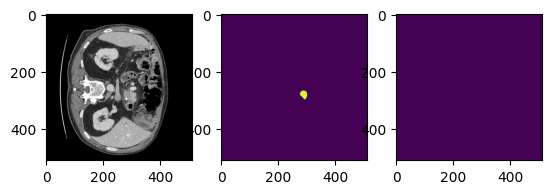

In [30]:
sample_id = 11 # 28
TARGET_IOU = 1
MODEL_THRESH = 0.48
EVAL_MAX_CLICKS = 20

use_init_mask = False

sample = dataset.get_sample(sample_id)

gt_mask = sample.gt_mask
image = sample.image
init_mask = np.zeros_like(gt_mask)

if use_init_mask and sample.init_mask is not None:
    init_mask = sample.init_mask
    
fig, ax = plt.subplots(1,3)
ax[0].imshow(image[:, :, 0], cmap='gray')
ax[1].imshow(gt_mask)
ax[2].imshow(init_mask)

In [31]:
# sample_id = 11 # 28
# TARGET_IOU = 1

# use_init_mask = False

# sample = dataset.get_sample(sample_id)

# gt_mask = sample.gt_mask
# image = sample.image
# init_mask = np.zeros_like(gt_mask)

# if use_init_mask and sample.init_mask is not None:
#     init_mask = sample.init_mask

clicker = DynamicClicker(gt_mask, mode='locked')


ious_arr = evaluate_sample(image, gt_mask, init_mask, predictor, clicker=clicker,
                                              pred_thr=MODEL_THRESH, max_iou_thr=TARGET_IOU, max_clicks=EVAL_MAX_CLICKS)

# clicks_list, ious_arr, pred, pred_list, info_list = evaluate_sample_explainable(image, gt_mask, predictor, 
#                                               pred_thr=MODEL_THRESH, 
#                                               max_iou_thr=TARGET_IOU, max_clicks=EVAL_MAX_CLICKS)

# pred_mask = pred_list[-1] > MODEL_THRESH
# draw = vis.draw_with_blend_and_clicks(image[:, :, 0], mask=pred_mask, clicks_list=clicks_list)
# draw = np.concatenate((draw,
#     255 * pred_mask[:, :, np.newaxis].repeat(3, axis=2),
#     255 * (gt_mask > 0)[:, :, np.newaxis].repeat(3, axis=2)
# ), axis=1)
print(np.round(ious_arr, 3))
# plt.figure(figsize=(12, 18))
# plt.imshow(draw)
# plt.show()

[0.721 0.727 0.727 0.727 0.727 0.727 0.729 0.73  0.73  0.73  0.751 0.845
 0.855 0.855 0.856 0.856 0.857 0.86  0.858 0.859]


# Visualise progression graph:

In [63]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
import base64

def show_animation(animation):
    html = animation.to_jshtml()
    
    return HTML(html)

def show_animation_from_file(filename):
    
    with open(filename, 'rb') as f:
        gif_data = f.read()

    gif_base64 = base64.b64encode(gif_data).decode('utf-8')

    html_code = f'<img src="data:image/gif;base64,{gif_base64}">'
    return HTML(html_code)

def save_animation(animation, filename):
    animation.save(f'{filename}.gif', writer='pillow')

def generate_click_animation(image, gt_mask, iou_values, clicks, predictions):
    fig, ax = plt.subplots(1, 3, figsize=(24, 8))
        
    iou_values = np.append(np.array([0]), iou_values)
    
    num_frames = len([iou_val for iou_val in iou_values if not np.isnan(iou_val)])
        
    ax[0].imshow(image, cmap='gray')
    ax[0].axis('off')
    ax[0].set_title('Clicks: 0', fontsize=20)
    ax[0].contour(gt_mask, colors='b', alpha=0.5, linewidths=0.1)
    
    ax[1].axis('off')
    ax[1].imshow(image, cmap='gray')
    ax[1].set_title(f'IOU: {0.}', fontsize=20)
    
    ax[2].set_xticks(np.arange(1, len(iou_values)+1))
    ax[2].set_ylim(0, 1.05)
    ax[2].set_xlabel('Clicks')
    ax[2].set_ylabel('IOU')
    ax[2].set_title('IOU after each click', fontsize=20)
    
    plt.close()
    
    def update(frame_index):
        ax[0].imshow(image, cmap='gray')
        ax[0].set_title(f'Clicks: {frame_index}', fontsize=20)
        ax[0].contour(gt_mask, colors='b', alpha=0.5, linewidths=0.1)
        for click in clicks[:frame_index]:
            color = 'lime' if click.is_positive else 'r'
            y, x = click.coords
            ax[0].scatter(x, y, s=20, c=color)
        
        ax[1].imshow(image, cmap='gray')
        if (frame_index > 0):
            prediction_masked = np.ma.masked_where(predictions[frame_index-1] == 0, predictions[frame_index-1])
            ax[1].imshow(prediction_masked, alpha=0.5, cmap='gist_rainbow')
            ax[1].set_title(f'IOU: {iou_values[frame_index]:.3f}', fontsize=20)
            
        ax[2].plot(np.arange(frame_index + 1), iou_values[:frame_index + 1], color='b')
        
        return
    
    animation = FuncAnimation(fig, update, frames=num_frames, interval=1000, blit=False)
    return animation

anim = generate_click_animation(image[:, :, 0], gt_mask, ious_arr, clicks_list, pred_list)
show_animation(anim)

## Visualise each part

In [64]:
step_info = info_list[10]

In [65]:
step_info.keys()

dict_keys(['original_image', 'prev_mask', 'input_image', 'image_transforms', 'coarse_seg', 'coarse_seg_prediction'])

In [66]:
np.unique(step_info['coarse_seg']['click_map'].cpu()[0, 0].numpy(), return_counts=True)

(array([0.0000000e+00, 1.4012985e-45, 2.8025969e-45, ..., 9.9902391e-01,
        9.9951184e-01, 1.0000000e+00], dtype=float32),
 array([ 1,  9, 11, ...,  5, 15, 10]))

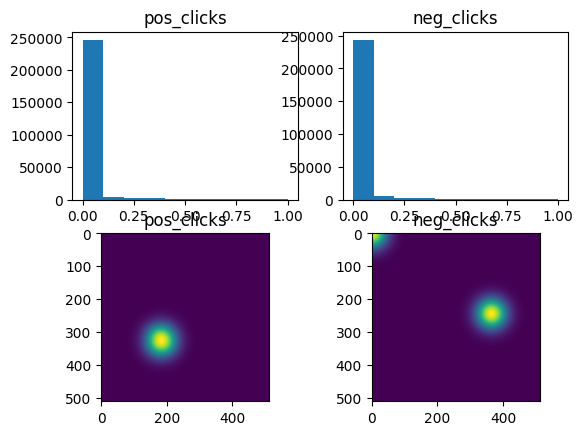

In [67]:
def show_coarse_input(info):
    
    info = info['coarse_seg']
    
    fig, ax = plt.subplots(2, 2)
    plt.close()
    
    ax[0, 0].set_title('pos_clicks')
    ax[0, 0].hist(info['click_map'].cpu()[0, 0].numpy().flatten())
    
    ax[0, 1].set_title('neg_clicks')
    ax[0, 1].hist(info['click_map'].cpu()[0, 1].numpy().flatten())
    
    ax[1, 0].set_title('pos_clicks')
    ax[1, 0].imshow(info['click_map'].cpu()[0, 0])
    
    ax[1, 1].set_title('neg_clicks')
    ax[1, 1].imshow(info['click_map'].cpu()[0, 1])
    
    return fig

show_coarse_input(step_info)

(array([1.05000e+02, 1.43527e+05, 3.14090e+04, 5.12360e+04, 2.57440e+04,
        7.37800e+03, 2.21500e+03, 4.54000e+02, 6.40000e+01, 1.20000e+01]),
 array([-29.128653 ,  -6.3521094,  16.424435 ,  39.200977 ,  61.97752  ,
         84.75407  , 107.53061  , 130.30714  , 153.0837   , 175.86023  ,
        198.63678  ], dtype=float32),
 <BarContainer object of 10 artists>)

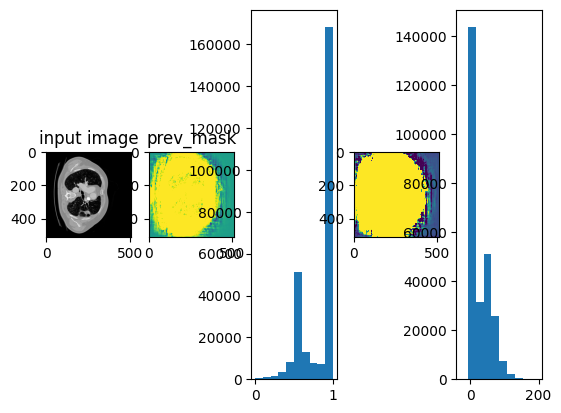

In [87]:
fig, ax = plt.subplots(1, 5)
ax[0].set_title('input image')
ax[0].imshow(step_info['image_transforms']['image_nd'].cpu()[0, 0], cmap='gray')
ax[1].set_title('prev_mask')
ax[1].imshow(step_info['prev_mask'], vmin=0, vmax=1)
ax[2].hist(step_info['prev_mask'].flatten())
ax[3].imshow(step_info['coarse_seg_prediction'], vmin=0, vmax=1)
ax[4].hist(step_info['coarse_seg_prediction'].flatten())

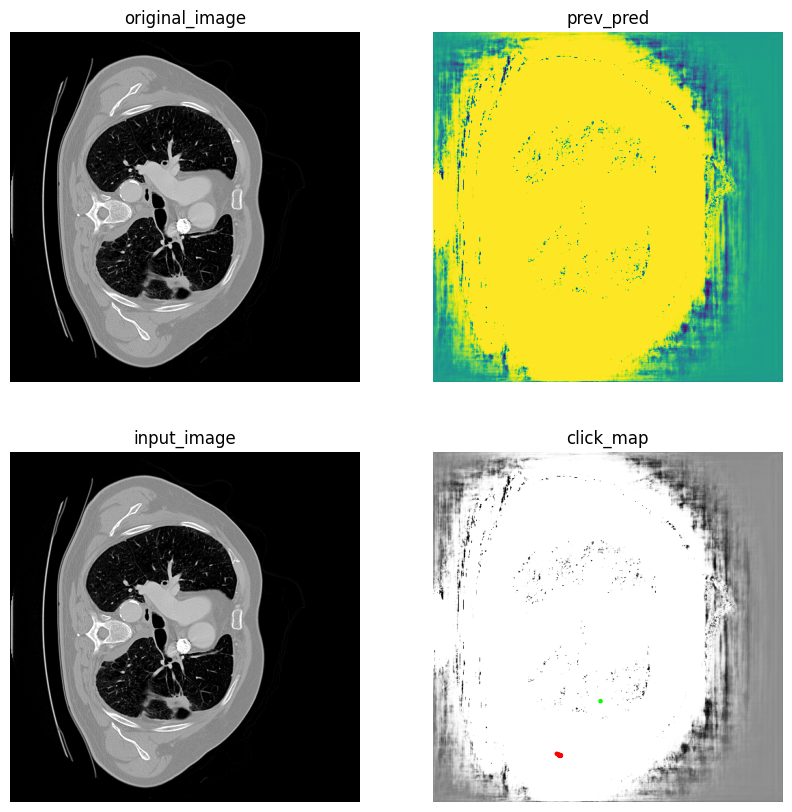

In [88]:
def show_before_coarse(info):
    fig, ax = plt.subplots(2, 2, figsize=(10, 10))
    plt.close()
    
    ax[0,0].set_title('original_image')
    ax[0,0].imshow(info['original_image'][0], cmap='gray')
    ax[0,0].axis('off')
    
    ax[0,1].set_title('prev_pred')
    ax[0,1].imshow(info['prev_mask'])
    ax[0,1].axis('off')
    
    ax[1,0].set_title(f'input_image')
    ax[1,0].imshow(info['image_transforms']['image_nd'].cpu()[0, 0], cmap='gray')
    ax[1,0].axis('off')
    
    ax[1,1].set_title('click_map')
    ax[1,1].imshow(info['image_transforms']['image_nd'].cpu()[0, 3], cmap='gray')
    ax[1,1].axis('off')
    y = [click.coords[0] for click in info['image_transforms']['clicks_lists'][0]]
    x = [click.coords[1] for click in info['image_transforms']['clicks_lists'][0]]
    c = [click.is_positive for click in info['image_transforms']['clicks_lists'][0]]
    c = ['lime' if i else 'red' for i in c]
    ax[1,1].scatter(x, y, c=c, s=5)
    
    return fig

show_before_coarse(step_info)

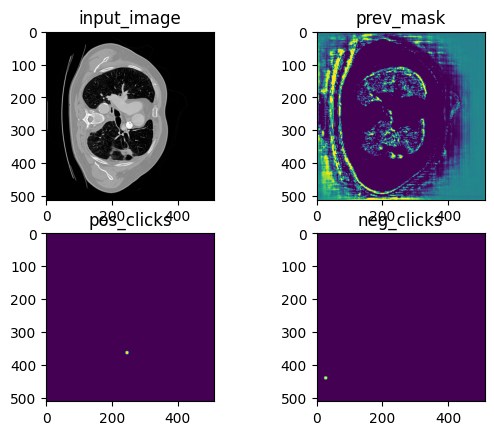

In [ ]:
def show_coarse_input(info):
    
    info = info['coarse_seg']
    
    fig, ax = plt.subplots(2, 2)
    plt.close()
    
    ax[0, 0].set_title('input_image')
    ax[0, 0].imshow(info['prepared_input']['image'].cpu()[0, 0], cmap='gray')
    
    ax[0, 1].set_title('prev_mask')
    ax[0, 1].imshow(info['prepared_input']['prev_mask'].cpu()[0, 0])
    
    ax[1, 0].set_title('pos_clicks')
    ax[1, 0].imshow(info['click_map'].cpu()[0, 0])
    
    ax[1, 1].set_title('neg_clicks')
    ax[1, 1].imshow(info['click_map'].cpu()[0, 1])
    
    return fig

show_coarse_input(step_info)

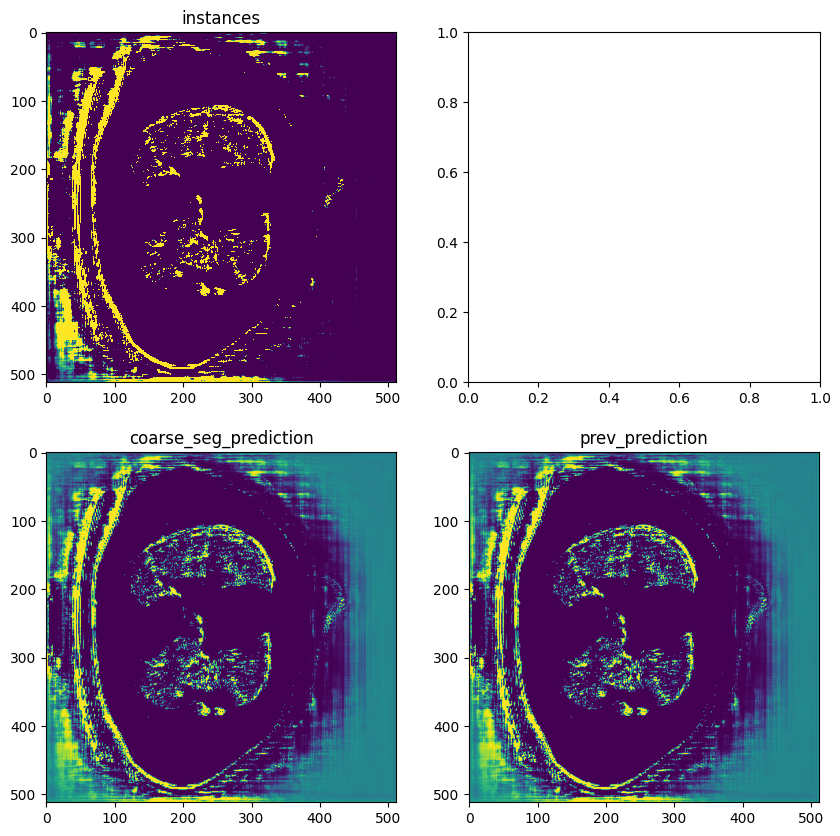

In [ ]:
def show_coarse_predictions(info):

    fig, ax = plt.subplots(2, 2, figsize=(10, 10))
    plt.close()
    
    ax[0, 0].set_title('instances')
    ax[0, 0].imshow(info['coarse_seg']['outputs']['instances'].cpu()[0, 0], vmin=0, vmax=1)
    
    # ax[0, 1].set_title('instances_aux')
    # ax[0, 1].imshow(info['coarse_seg']['outputs']['instances_aux'].cpu()[0, 0])
    
    ax[1, 0].set_title('coarse_seg_prediction')
    new_mask = torch.sigmoid(info['coarse_seg']['outputs']['instances'].cpu()[0, 0]).numpy()
    ax[1, 0].imshow(new_mask, vmin=0, vmax=1)
    
    ax[1,1].set_title('prev_prediction')
    ax[1,1].imshow(info['coarse_seg']['prepared_input']['prev_mask'].cpu()[0, 0], vmin=0, vmax=1)
    
    return fig

show_coarse_predictions(step_info)

## Animation code

In [ ]:
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
import base64

def show_animation(animation):
    html = animation.to_jshtml()
    
    return HTML(html)

def show_animation_from_file(filename):
    
    with open(filename, 'rb') as f:
        gif_data = f.read()

    gif_base64 = base64.b64encode(gif_data).decode('utf-8')

    html_code = f'<img src="data:image/gif;base64,{gif_base64}">'
    return HTML(html_code)

def save_animation(animation, filename):
    animation.save(f'{filename}.gif', writer='pillow')
    
def generate_click_animation(image, gt_mask, iou_values, clicks, predictions, info_list):
    fig, ax = plt.subplots(2, 3, figsize=(9, 7))
    if len(image.shape) == 3:
        image = image[:, :, 0]
        
    num_frames = len(clicks)
        
    ax[0,0].imshow(image, cmap='gray')
    ax[0,0].axis('off')
    ax[0,0].set_title('Image, gt mask,\nClicks', fontsize=20)
    ax[0,0].contour(gt_mask, colors='b', alpha=0.5, linewidths=0.1)

    ax[1, 1].set_title('Coarse logits')
    
    plt.close()
    
    def update(frame_index):
        
        fig.suptitle(f'Click {frame_index + 1}', fontsize=20)
        
        ax[0,0].imshow(image, cmap='gray')
        ax[0,0].set_title(f'Clicks: {frame_index + 1}', fontsize=20)
        ax[0,0].contour(gt_mask, colors='b', alpha=0.5, linewidths=0.1)
        for click in clicks[:frame_index + 1]:
            color = 'lime' if click.is_positive else 'r'
            y, x = click.coords
            ax[0,0].scatter(x, y, s=10, c=color)
            
        ax[0,1].clear()
        ax[0,1].set_title('Previous predicition', fontsize=20)
        ax[0,1].axis('off')
        ax[0,1].imshow(info_list[frame_index]['prev_mask'])
        
        ax[0,2].clear()
        ax[0,2].axis('off')
        ax[0,2].set_title(f'Input image', fontsize=20)
        ax[0,2].imshow(info_list[frame_index]['image_transforms']['image_nd'].cpu()[0, 0], cmap='gray')
        
        image_transforms = info_list[frame_index]['image_transforms']
        ax[1,0].clear()
        ax[1,0].set_title('Click map', fontsize=20)
        ax[1,0].axis('off')
        ax[1,0].imshow(image_transforms['image_nd'].cpu()[0, 3], cmap='gray')
        
        start_y, end_y, start_x, end_x = (0,0,512,512)
        cur_clicks = image_transforms['clicks_lists'][0]
        y = [click.coords[0] for click in image_transforms['clicks_lists'][0]]
        x = [click.coords[1] for click in image_transforms['clicks_lists'][0]]
        c = [click.is_positive for click in image_transforms['clicks_lists'][0]]
        c = ['lime' if i else 'red' for i in c]
        ax[1,0].scatter(x, y, c=c, s=20)
        
        ax[1,1].clear()
        ax[1,1].set_title('Coarse prediction', fontsize=20)
        ax[1,1].axis('off')
        ax[1,1].imshow(info_list[frame_index]['coarse_seg_prediction'])
        
        ax[1,2].clear()
        ax[1,2].axis('off')
        ax[1,2].set_title(f'Final prediction', fontsize=20)
        ax[1,2].imshow(predictions[frame_index])
        
        return
    
    animation = FuncAnimation(fig, update, frames=num_frames, interval=1000, blit=False)
    return animation

In [ ]:
anim = generate_click_animation(image, gt_mask, ious_arr, clicks_list, pred_list, info_list)
show_animation(anim)